In [19]:
# ======================
# IMPORTS AND SETUP
# ======================
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from collections import defaultdict
import warnings
import time
from requests.exceptions import RequestException


# Machine Learning imports
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
from yellowbrick.target import FeatureCorrelation

# Spotify API imports
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from dotenv import load_dotenv

# Configuration
%matplotlib inline
warnings.filterwarnings("ignore")
plt.rcParams['figure.figsize'] = (20, 20)
sns.set(rc={'figure.figsize': (11, 6)})

In [2]:
# ======================
# DATA LOADING
# ======================
data = pd.read_csv(r"C:\Users\m7md7\Desktop\New folder (4)\data.csv")
genre_data = pd.read_csv(r"C:\Users\m7md7\Desktop\New folder (4)\data_by_genres.csv")
year_data = pd.read_csv(r"C:\Users\m7md7\Desktop\New folder (4)\data_by_year.csv")

# Print data info
print(data.info())
print(genre_data.info())
print(year_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

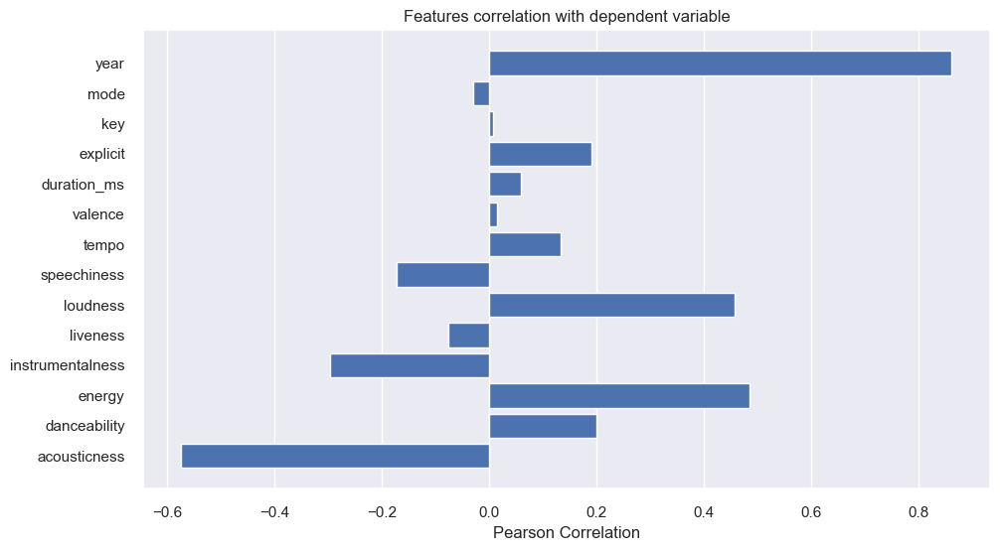

<Axes: title={'center': 'Features correlation with dependent variable'}, xlabel='Pearson Correlation'>

In [ ]:
# ======================
# FEATURE ANALYSIS
# ======================
feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness',
                'liveness', 'loudness', 'speechiness', 'tempo', 'valence',
                'duration_ms', 'explicit', 'key', 'mode', 'year']

X, y = data[feature_names], data['popularity']
features = np.array(feature_names)

# Feature correlation visualization
visualizer = FeatureCorrelation(labels=features)
visualizer.fit(X, y)
visualizer.show()

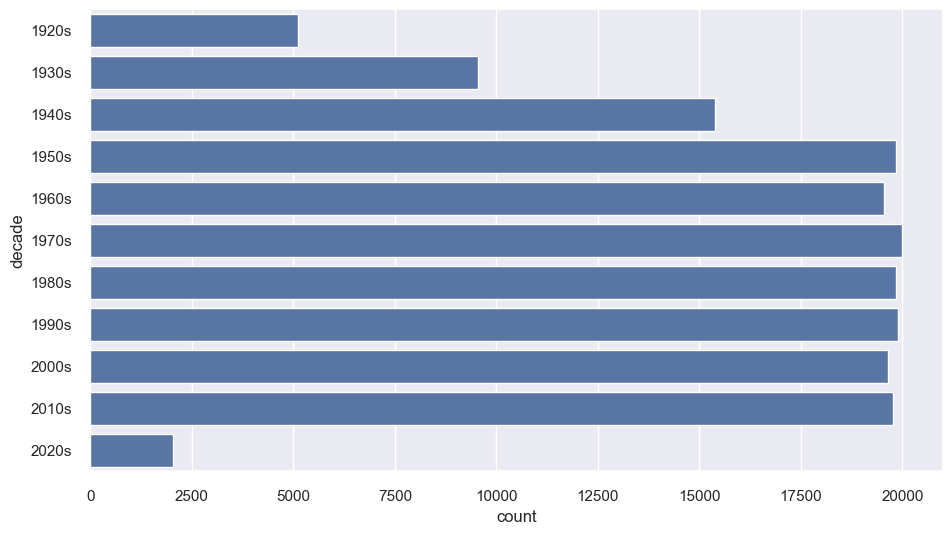

In [4]:
# ======================
# DATA VISUALIZATION
# ======================
# Decade analysis
def get_decade(year):
    period_start = int(year/10) * 10
    return f'{period_start}s'

data['decade'] = data['year'].apply(get_decade)
sns.countplot(data['decade'])

# Sound features over time
sound_features = ['acousticness', 'danceability', 'energy', 
                 'instrumentalness', 'liveness', 'valence']
fig = px.line(year_data, x='year', y=sound_features)
fig.show()

# Top genres visualization
top10_genres = genre_data.nlargest(10, 'popularity')
fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], 
             barmode='group')
fig.show()

In [5]:
# ======================
# CLUSTERING MODELS
# ======================
# Genre clustering
cluster_pipeline = Pipeline([
    ('scaler', StandardScaler()), 
    ('kmeans', KMeans(n_clusters=10, n_init=10))
])

X_genre = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X_genre)
genre_data['cluster'] = cluster_pipeline.predict(X_genre)

# Song clustering
song_cluster_pipeline = Pipeline([
    ('scaler', StandardScaler()), 
    ('kmeans', KMeans(n_clusters=20, verbose=0, n_init=10))
], verbose=False)

X_song = data.select_dtypes(np.number)
number_cols = list(X_song.columns)
song_cluster_pipeline.fit(X_song)
data['cluster_label'] = song_cluster_pipeline.predict(X_song)

In [6]:
# ======================
# DIMENSIONALITY REDUCTION & VISUALIZATION
# ======================
# Genre visualization with t-SNE
tsne_pipeline = Pipeline([
    ('scaler', StandardScaler()), 
    ('tsne', TSNE(n_components=2, verbose=1))
])
genre_embedding = tsne_pipeline.fit_transform(X_genre)

projection_genre = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection_genre['genres'] = genre_data['genres']
projection_genre['cluster'] = genre_data['cluster']

fig = px.scatter(
    projection_genre, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()

# Song visualization with PCA
pca_pipeline = Pipeline([
    ('scaler', StandardScaler()), 
    ('PCA', PCA(n_components=2))
])
song_embedding = pca_pipeline.fit_transform(X_song)

projection_song = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection_song['title'] = data['name']
projection_song['cluster'] = data['cluster_label']

fig = px.scatter(
    projection_song, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.024s...
[t-SNE] Computed neighbors for 2973 samples in 0.801s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.106117
[t-SNE] KL divergence after 1000 iterations: 1.393164


In [7]:
# ======================
# SPOTIFY API INTEGRATION
# ======================
# Install required packages (commented out as they're usually run separately)
# !pip install spotipy python-dotenv

# Initialize Spotify client
load_dotenv()
SPOTIFY_CLIENT_ID = os.getenv("SPOTIFY_CLIENT_ID")
SPOTIFY_CLIENT_SECRET = os.getenv("SPOTIFY_CLIENT_SECRET")

sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(
    client_id=SPOTIFY_CLIENT_ID,
    client_secret=SPOTIFY_CLIENT_SECRET
))

def find_song(name, year):
    song_data = defaultdict()
    try:
        results = sp.search(q=f'track: {name} year: {year}', limit=1)

        if not results['tracks']['items']:
            return None

        track = results['tracks']['items'][0]
        track_id = track['id']
        audio_features = sp.audio_features(track_id)[0]

        song_data['name'] = [name]
        song_data['year'] = [year]
        song_data['explicit'] = [int(track['explicit'])]
        song_data['duration_ms'] = [track['duration_ms']]
        song_data['popularity'] = [track['popularity']]

        for key, value in audio_features.items():
            song_data[key] = value

        return pd.DataFrame(song_data)
    
    except Exception as e:
        print(f"Error occurred: {e}")
        return None

In [8]:
# ======================
# RECOMMENDATION SYSTEM
# ======================
def get_song_data(song, spotify_data):
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data
    except IndexError:
        return find_song(song['name'], song['year'])

def get_mean_vector(song_list, spotify_data):
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print(f'Warning: {song["name"]} does not exist in Spotify or in database')
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)

def flatten_dict_list(dict_list):
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict

def recommend_songs(song_list, spotify_data, n_songs=10):
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)
    
    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')


In [28]:
# ======================
# TEST AND DISPLAY RECOMMENDATIONS 
# ======================
def display_recommendations(input_songs, recommendations):
    import pandas as pd
    from IPython.display import display, HTML
    
    try:
        # Prepare DataFrames with unique indices
        input_df = pd.DataFrame(input_songs).reset_index(drop=True)
        input_df['type'] = 'Input'
        
        rec_df = pd.DataFrame(recommendations).reset_index(drop=True)
        rec_df['type'] = 'Recommendation'
        
        # Combine and ensure uniqueness
        combined = pd.concat([input_df, rec_df]).reset_index(drop=True)
        
        # Create styled output
        def style_songs(s):
            return [
                'background-color: #e6f7ff' if typ == 'Input' 
                else 'background-color: #f0fff0' 
                for typ in s
            ]
        
        styled = (combined.style
                 .apply(style_songs, subset=['type'])
                 .set_properties(**{
                     'padding': '6px',
                     'font-size': '14px',
                     'border': '1px solid #ddd'
                 })
                 .set_table_styles([{
                     'selector': 'th',
                     'props': [('background-color', '#0074D9'), 
                              ('color', 'white'),
                              ('font-weight', 'bold')]
                 }])
                )
        
        # Display results
        display(HTML("<h3 style='color:#0074D9'>🎵 Recommended Songs</h3>"))
        display(styled)
        
            
            
    except Exception as e:
        display(HTML(f"<div style='color:red; padding:10px;'>"
                   f"❌ Error: {str(e)}</div>"))

# Test with sample data
test_songs = [
    {'name': 'Come As You Are', 'year': 1991},
    {'name': 'Smells Like Teen Spirit', 'year': 1991},
    {'name': 'Lithium', 'year': 1992},
    {'name': 'All Apologies', 'year': 1993},
    {'name': 'Stay Away', 'year': 1993}
]

try:
    recommendations = recommend_songs(test_songs, data, n_songs=5)
    display_recommendations(test_songs, recommendations)
except Exception as e:
    print(f"Error in recommendation system: {str(e)}")

,name,year,type,artists
0,Come As You Are,1991,Input,nan
1,Smells Like Teen Spirit,1991,Input,nan
2,Lithium,1992,Input,nan
3,All Apologies,1993,Input,nan
4,Stay Away,1993,Input,nan
5,Hanging By A Moment,2000,Recommendation,['Lifehouse']
6,Kiss Me,1997,Recommendation,['Sixpence None The Richer']
7,Breakfast At Tiffany's,1995,Recommendation,['Deep Blue Something']
8,Otherside,1999,Recommendation,['Red Hot Chili Peppers']
9,It's Not Living (If It's Not With You),2018,Recommendation,['The 1975']
